# Sing with Charles

Data captured originally with OpenFace FeatureExtraction.

A reminder of [Action Units](https://www.cs.cmu.edu/~face/facs.htm) and [landmarks](https://github.com/TadasBaltrusaitis/OpenFace/wiki/Output-Format).

In [1]:
# In case needed
#!{sys.executable} -m pip install -U pip
#!{sys.executable} -m pip install -r requirements.txt

In [15]:
from time import time, sleep
from datetime import datetime, timedelta
import IPython.display as ipd
import sys
# The usual suspects
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scipy.signal
%matplotlib notebook

In [2]:
from charles import Charles
from utils import Input, DirectMapping, FakeSinMapping

In [187]:
charles = Charles()
charles.initialise()

print("Waking up")
charles.outputs["NOD"].set_float_pos(0.5, 30)
charles.wait_until_still()

Testing SSC
Firmware version: SSC32-V2.03XE
Done
Initialising...
Powering up face servos
Waiting for SSC
Waiting until still
Done
Waking up


Here are the standard mappings copied originally from the mimic code but identified by the name of the CSV columns:

In [7]:
# Do we want Charles to mirror or copy?
MIRROR = False

##########################
### Define OpenFace inputs
##########################

# AU Intensity is 0-5 or 0-1

# Note that in this version we're using the column names from the CSV

inputs = {
    "EULER_X": Input("GLOBAL", "pose_Rx", center=0, range=0.8), # -ve: Nod Down
    "EULER_Y": Input("GLOBAL", "pose_Ry", center=0, range=0.8), # +ve: Turn Right
    "EULER_Z": Input("GLOBAL", "pose_Rz", center=0, range=0.8), # +ve: Tilt Left

    "INNER_BROW_RAISE": Input("AU", "AU01_r", min=0, max=5, expand=True),
    "OUTER_BROW_RAISE": Input("AU", "AU02_r", min=0, max=4.5),
    "BROW_LOWERER": Input("AU", "AU04_r", min=0, max=2.5),
    "UPPER_LID_RAISER": Input("AU", "AU05_r", min=-0.5, max=1.4),
    "CHEEK_RAISER": Input("AU", "AU06_r", min=0, max=2.6),
    # "LID_TIGHTENER": Input("AU", "AU07_r", min=0, max=5),
    "NOSE_WRINKLER": Input("AU", "AU09_r", min=0, max=1.8),
    "UPPER_LIP_RAISER": Input("AU", "AU10_r", min=0, max=4),
    "LIP_CORNER_PULLER": Input("AU", "AU12_r", min=0, max=3.2),
    
    #"DIMPLER": Input("AU", "AU14_r", min=1.5, max=3),
    #"LIP_CORNER_DEPRESSOR": Input("AU", "AU15_r", min=1.5, max=3),
    #"CHIN_RAISER": Input("AU", "AU17_r", min=1.5, max=3),
    "LIP_STRETCHER": Input("AU", "AU20_r", min=1.5, max=3),
    #"LIP_TIGHTENER": Input("AU", "AU23_r", min=0, max=3),
    #"LIPS_PART": Input("AU", "AU25_r", min=1.5, max=3),
    "JAW_DROP": Input("AU", "AU26_r", min=0.1, max=2.6),
    #"BLINK": Input("AU", "AU45_r", min=0, max=1),
}

##########################################
### Define mappings from inputs to outputs
##########################################

# For brevity:
outputs = charles.outputs

mappings = [

    # Head pose and eyes

    DirectMapping(inputs["EULER_X"], [outputs["NOD"], outputs["EYES_UP_DOWN"]], reverse=True),
    DirectMapping(inputs["EULER_Y"], [outputs["TURN"],
                                      outputs["LEFT_EYE_TURN"],
                                      outputs["RIGHT_EYE_TURN"]], reverse=not MIRROR),
    DirectMapping(inputs["EULER_Z"], [outputs["TILT"]], reverse=not MIRROR),

    DirectMapping(inputs["UPPER_LID_RAISER"], [outputs["UPPER_EYE_LIDS"]]),
    DirectMapping(inputs["UPPER_LID_RAISER"], [outputs["LOWER_EYE_LIDS"]], 
                  reverse=True),

    # Brows

    DirectMapping(inputs["INNER_BROW_RAISE"], [outputs["CENTER_BROW"],
                                               outputs["INNER_BROW_LEFT"],
                                               outputs["OUTER_BROW_LEFT"],
                                               outputs["INNER_BROW_RIGHT"],
                                               outputs["OUTER_BROW_RIGHT"]], reverse=True),

    # Mid face

    DirectMapping(inputs["CHEEK_RAISER"], [outputs["SQUINT_RIGHT"], outputs["SQUINT_LEFT"]]),
    DirectMapping(inputs["NOSE_WRINKLER"], [outputs["CENTER_BROW"], outputs["SNEER_RIGHT"], outputs["SNEER_LEFT"]]),

    # Mouth
    DirectMapping(inputs["LIP_CORNER_PULLER"], [outputs["EE_OO"]]),
    DirectMapping(inputs["UPPER_LIP_RAISER"], [outputs["UPPER_LIP_LEFT"],
                                               outputs["UPPER_LIP_CENTER"],
                                               outputs["UPPER_LIP_RIGHT"],
                                               outputs["SMILE_FROWN_RIGHT"],
                                               outputs["SMILE_FROWN_LEFT"]]),
    DirectMapping(inputs["JAW_DROP"], [outputs["JAW"]]),
]



In [8]:
CSV_FILE = "/Volumes/LaCie RAID/Opera/Dwayne Croft/Dwayne_Croft_Avant_de_Quitter.csv"
WAV_FILE = "/Volumes/LaCie RAID/Opera/Dwayne Croft/Dwayne_Croft_Avant_de_Quitter.wav"

In [9]:
df = pd.read_csv(CSV_FILE, skipinitialspace=True)
df

,frame,face_id,timestamp,confidence,success,gaze_0_x,gaze_0_y,gaze_0_z,gaze_1_x,gaze_1_y,...,AU12_c,AU14_c,AU15_c,AU17_c,AU20_c,AU23_c,AU25_c,AU26_c,AU28_c,AU45_c
0,1,0,0.00,0.00,0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2,0,0.04,0.00,0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,3,0,0.08,0.00,0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,4,0,0.12,0.00,0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,5,0,0.16,0.00,0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,6,0,0.20,0.00,0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,7,0,0.24,0.00,0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,8,0,0.28,0.00,0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,9,0,0.32,0.00,0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,10,0,0.36,0.00,0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Read in the background music...

In [12]:
from scipy.io import wavfile 
sample_rate, data = wavfile.read(WAV_FILE)

left, right = data[:,0], data[:,1]

ipd.Audio(data=left, rate=sample_rate)

In [161]:
# Start music playing.
# Probably easiest with 'play' key on keyboard when movie loaded

# Start reading AU values, perhaps with offset
# and playing them back through charles

def playback(df, velocity = 30, offset = -0.5):
    current_vals = {}
    # Here's an offset to allow for synchonising the audio and charles's latencies
    start = time() + offset
    for index, row in df.iterrows():
        ts = row['timestamp']
        now = time()-start
    #     print("{:.2f}".format(now), end=" ")
        if now < ts-0.2:
            sleep(ts-now)
        else:
            #print("skip")
            continue
        for name, inp in inputs.items():
            idx = inp.idx
            if inp.map not in current_vals:
                current_vals[inp.map] = {}
            current_vals[inp.map][idx] = row[idx]
        # print(current_vals)        
        for m in mappings:
            m.update(current_vals, velocity)

# playback(df)

## OpenFace on Charles

Read the values that come from recording Charles's mimicing, using Openface

In [111]:
dfc = pd.read_csv("webcam_2019-03-08-17-39.csv", skipinitialspace=True)
dfc.head()

,frame,face_id,timestamp,confidence,success,gaze_0_x,gaze_0_y,gaze_0_z,gaze_1_x,gaze_1_y,...,AU12_c,AU14_c,AU15_c,AU17_c,AU20_c,AU23_c,AU25_c,AU26_c,AU28_c,AU45_c
0,1,0,0.012,0.93,1,-0.075198,0.003427,-0.997163,-0.064622,-0.051088,...,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0
1,2,0,0.361,0.98,1,-0.073057,-0.131672,-0.988598,-0.067951,-0.180380,...,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0
2,3,0,0.554,0.98,1,-0.078068,-0.136017,-0.987626,-0.046911,-0.184568,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,4,0,0.658,0.98,1,-0.072348,-0.135713,-0.988103,-0.045594,-0.185926,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,5,0,0.752,0.98,1,-0.072960,-0.133853,-0.988312,-0.053212,-0.194972,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


Resample everything at a known frequency.  Both Charles and Dwayne. The 'c' suffix indicates Charles.

In [114]:
df['time'] = pd.to_datetime(df['timestamp'], unit='s')
dfc['time'] = pd.to_datetime(dfc['timestamp'], unit='s')

tdf = df.set_index('time')
tdfc = dfc.set_index('time')

tdf_sampled = tdf.resample("200ms").mean()
tdfc_sampled = tdfc.resample("200ms").mean()

Pick the AU we're interested in.

In [115]:
column = "AU26_r"
t_au_sampled = tdf_sampled[column]
t_au_sampledc = tdfc_sampled[column]

And let's see what they look like:

<IPython.core.display.Javascript object>


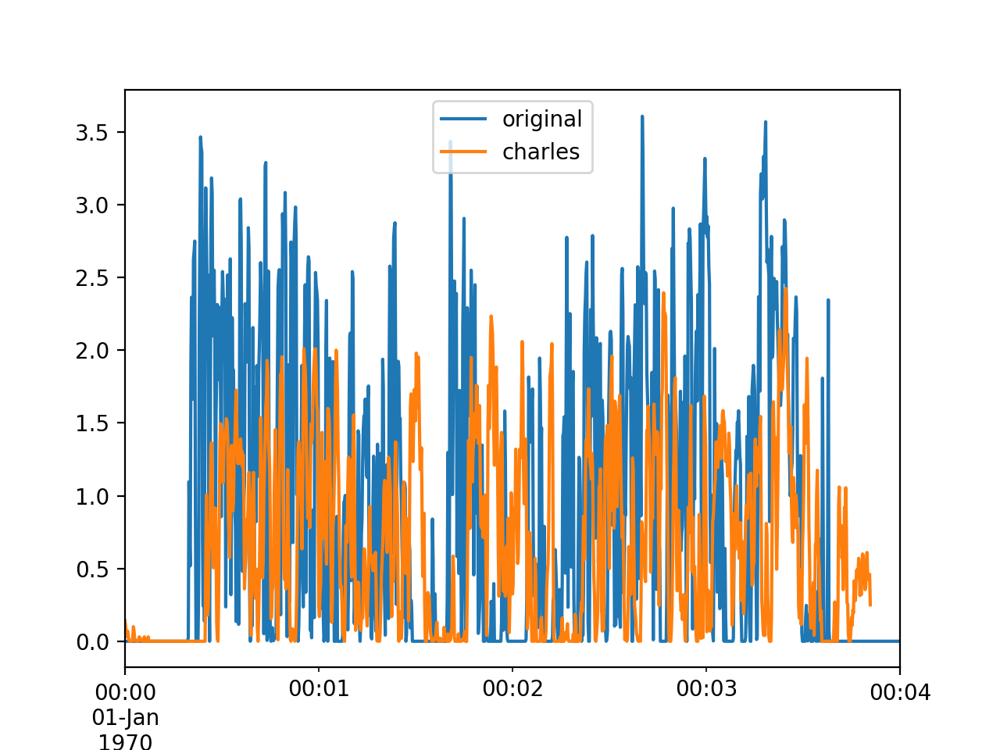

In [147]:

plt.figure()
t_au_sampled.plot(label="original", legend=True)
t_au_sampledc.plot(label="charles", legend=True)
plt.show()

The inputs are very noisy, so we smooth them with a rolling window, filling any gaps:

<IPython.core.display.Javascript object>


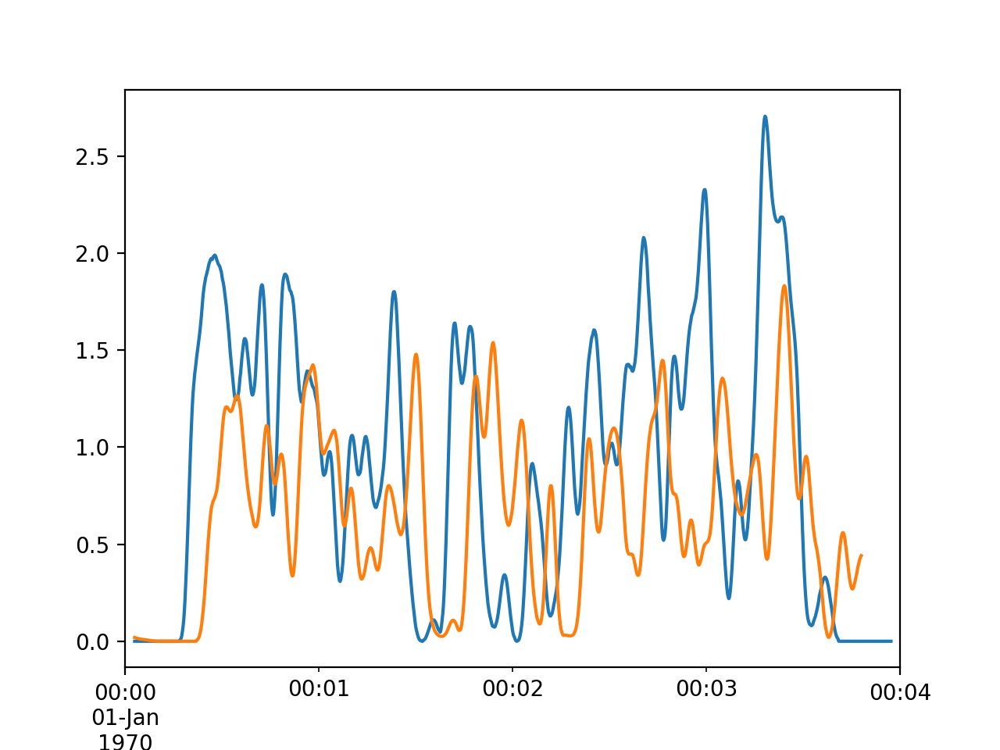

In [127]:
window_width = 30
smooth_au = t_au_sampled.rolling(window_width, center=True, win_type='hamming').mean()
smooth_auc = t_au_sampledc.rolling(window_width, center=True, win_type='hamming').mean()

smooth_au = smooth_au.interpolate(method='quadratic')
smooth_auc = smooth_auc.interpolate(method='quadratic')

plt.figure()
# tjaw_5fps.plot()
smooth_au.plot()
# tjawc_5fps.plot()
smooth_auc.plot()
plt.show()

Now we look for correlation, to determine the offset.  We take a section of the charles reading by chopping a margin off the beginning and end and then see where it best aligns.

<IPython.core.display.Javascript object>


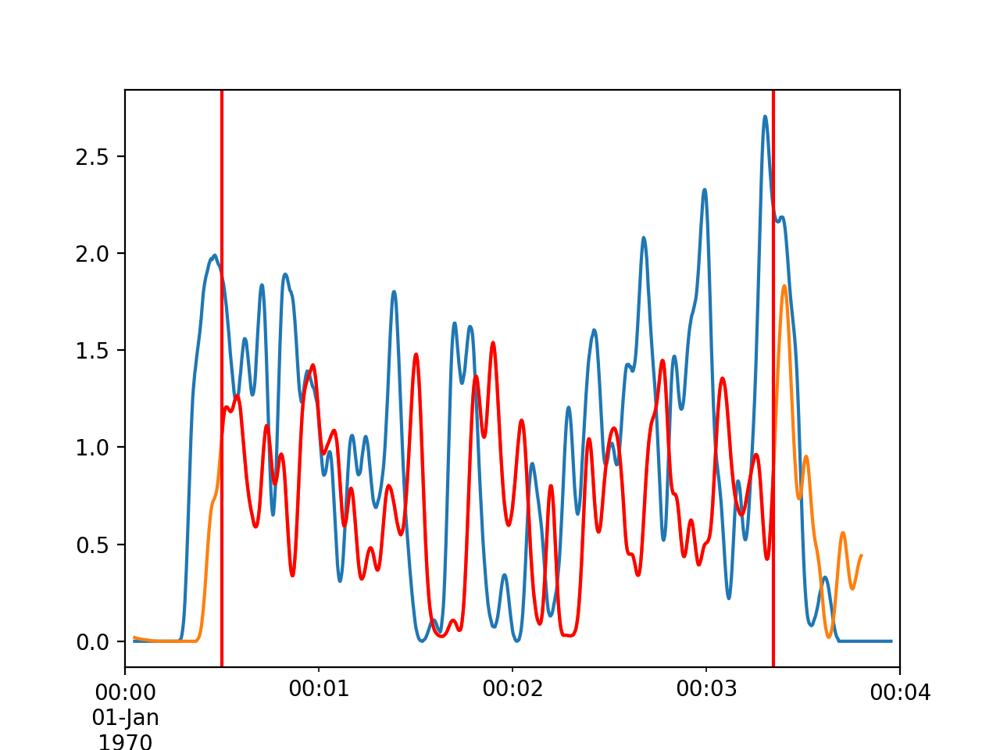

In [138]:
margin = timedelta(seconds=30)
smooth_auc_section = smooth_auc[smooth_auc.index[0]+margin:smooth_auc.index[-1]-margin]

plt.figure()
smoothjaw.plot()
smooth_auc.plot()
smooth_auc_section.plot(color='r')
plt.axvline(smooth_auc.index[0]+margin, color='r')
plt.axvline(smooth_auc.index[-1]-margin, color='r')
plt.show()

<IPython.core.display.Javascript object>


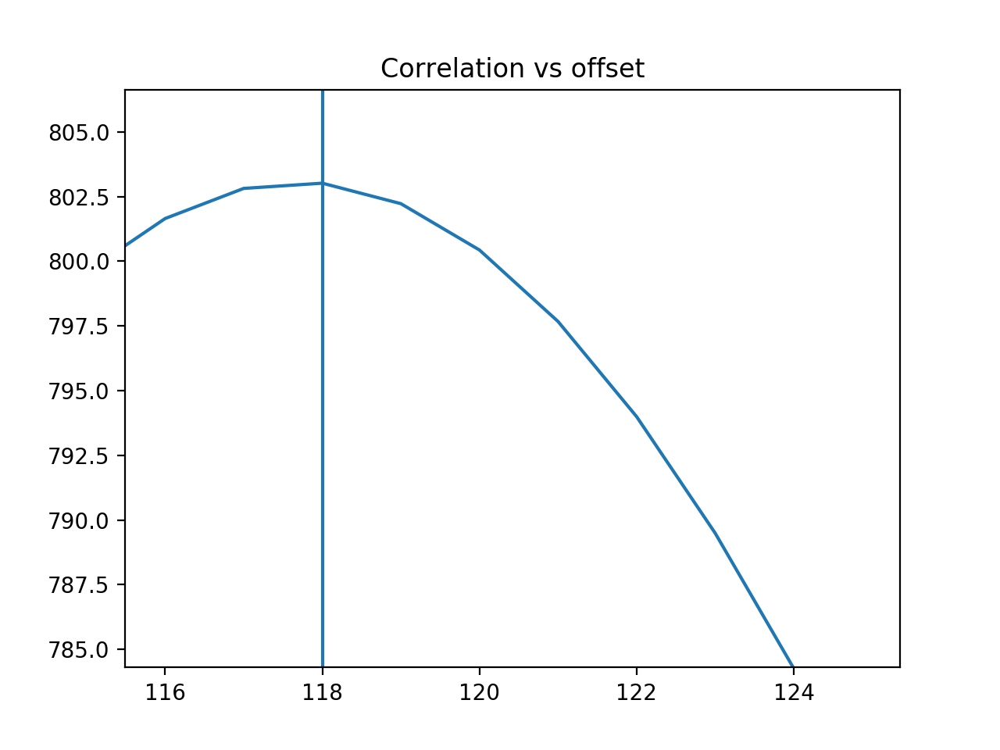

In [146]:
cor = scipy.signal.correlate(smooth_au.values, smooth_auc_section.values,  mode='valid')
offset = np.nanargmax(cor)

plt.figure()
ax = plt.subplot(1, 1, 1)
ax.set_title('Correlation vs offset')
plt.plot(cor)
plt.axvline(offset)
plt.show()


    

<IPython.core.display.Javascript object>


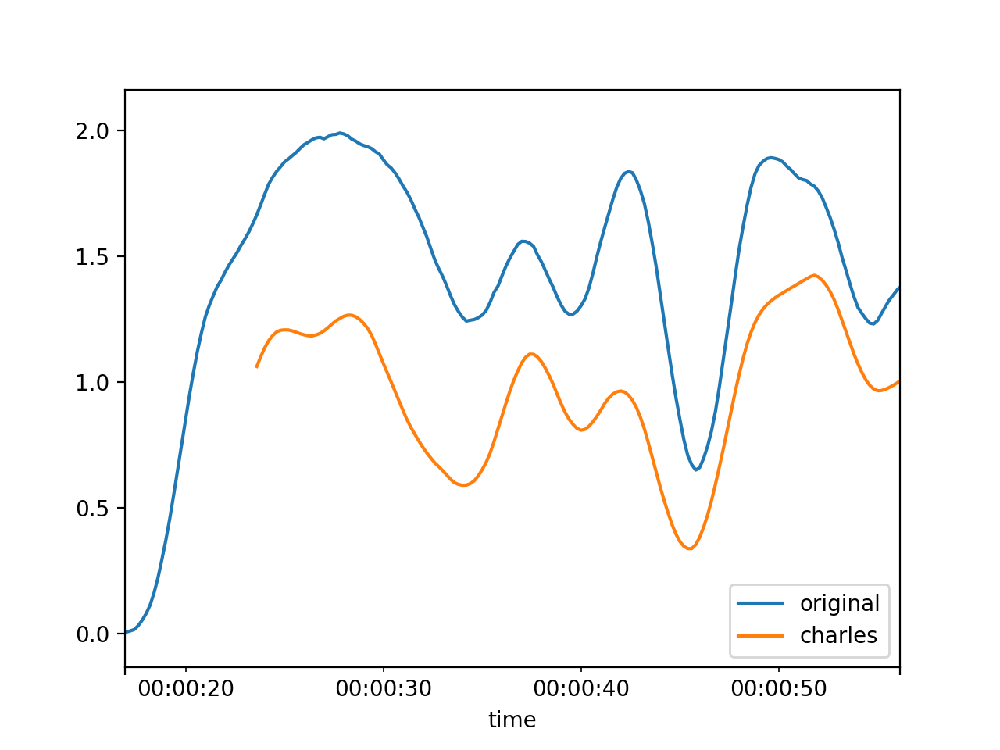

In [151]:
plt.figure()
smooth_au.plot(label="original", legend=True)
# smoothjawc.plot()
smooth_auc_section.shift(-1, freq=margin).shift(offset).plot(label="charles", legend=True)

plt.show()

Let's look at the original resampled noisy data now aligned:

<IPython.core.display.Javascript object>


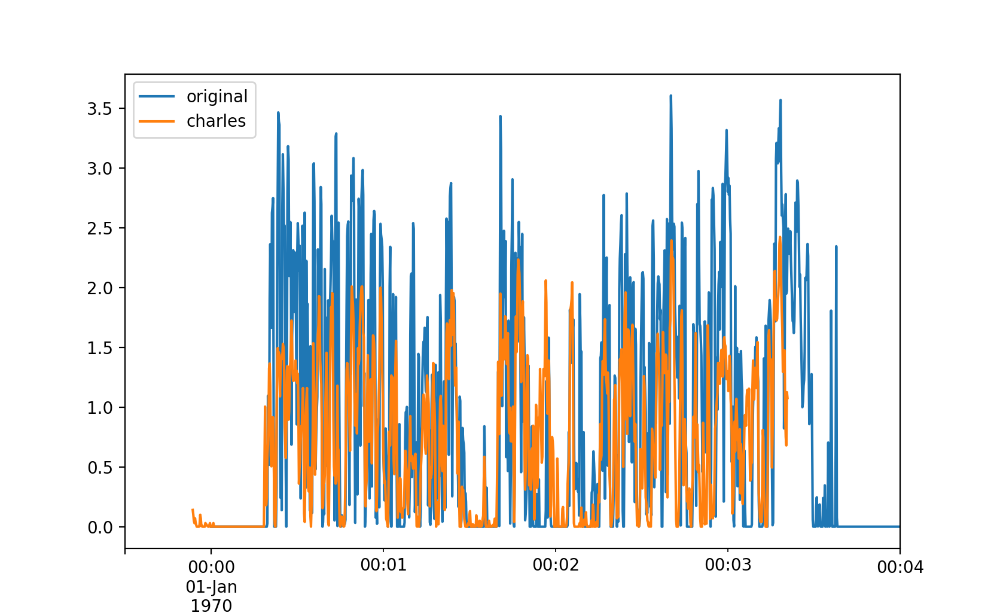

In [152]:
plt.figure()
t_au_sampled.plot(label="original", legend=True)
t_au_sampledc.shift(-1, freq=margin).shift(offset).plot(label="charles", legend=True)
plt.show()

<IPython.core.display.Javascript object>


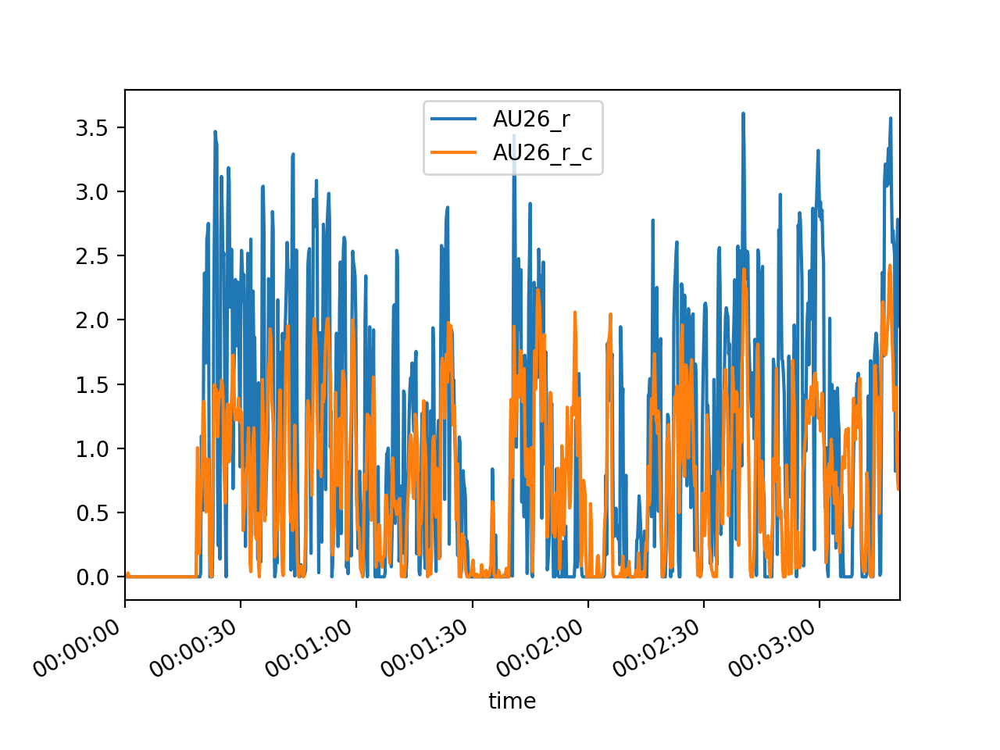

In [163]:
df_merged = pd.DataFrame(t_au_sampled).join(t_au_sampledc.shift(-1, freq=margin).shift(offset), rsuffix="_c")
df_merged = df_merged.dropna()
df_merged.plot()

In [164]:
df_merged.describe()

,AU26_r,AU26_r_c
count,1004.000000,1004.000000
mean,0.973867,0.703383
std,0.989205,0.623963
min,0.000000,0.000000
25%,0.000000,0.060000
50%,0.698000,0.612500
75%,1.752500,1.215000
max,3.608000,2.425000


What's the RMSE?

In [165]:
((df_merged['AU26_r'] - df_merged['AU26_r_c']) ** 2).mean() ** .5

0.7800572987489846

Look at how the original maps to Charles's output:

<IPython.core.display.Javascript object>


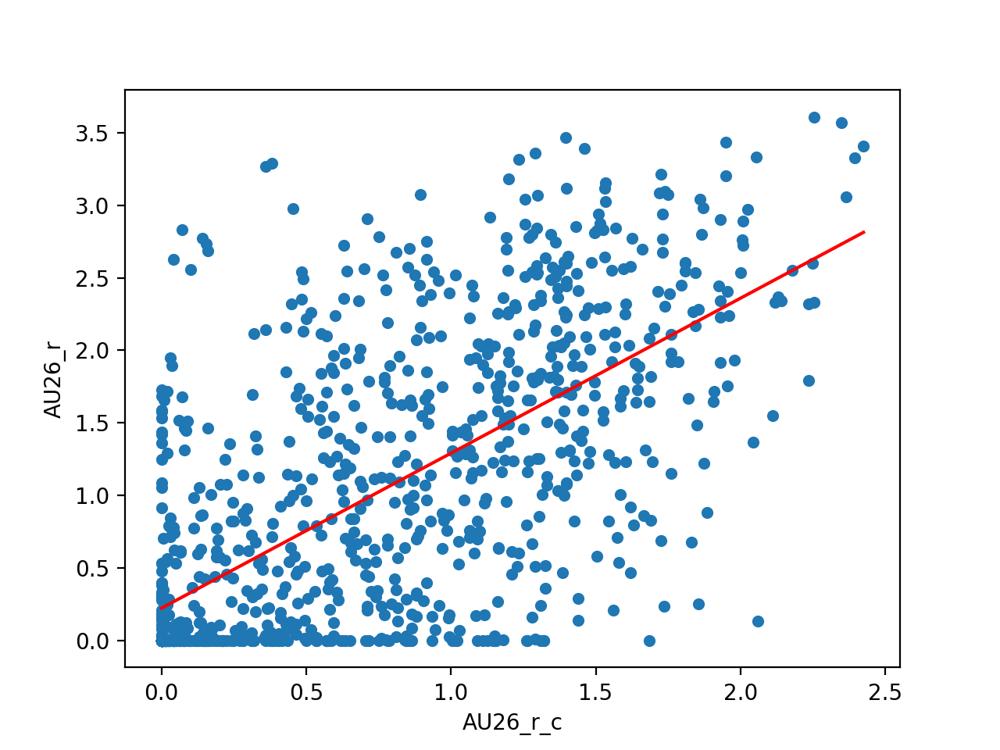

In [185]:
ax = df_merged.plot(x='AU26_r_c', y='AU26_r', kind='scatter')

# Work out a trend line
z = np.polyfit(x=df_merged['AU26_r_c'], y=df_merged['AU26_r'], deg=1)
p = np.poly1d(z)
endpoints = [df_merged['AU26_r_c'].min(), df_merged['AU26_r_c'].max()]
plt.plot(endpoints, p(endpoints), color='r')


In [186]:
p

poly1d([1.06849579, 0.22230461])